In [1]:
import numpy as np #For Linear Algebraic Functions
import pandas as pd #For Data Handling

#Data Visualization libraries
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

#For Logistic Regression
from sklearn import linear_model

import warnings
warnings.filterwarnings("ignore")


In [2]:
#Loading CSV Files

X_train = np.genfromtxt("C:/Users/Himanshu/Desktop/New folder/Logistic Regression/X_train.csv" , delimiter = ",")
Y_train=np.genfromtxt("C:/Users/Himanshu/Desktop/New folder/Logistic Regression/Y_train.csv" , delimiter = ",")
Y_test= np.genfromtxt("C:/Users/Himanshu/Desktop/New folder/Logistic Regression/Y_test.csv" , delimiter = ",")
X_test = np.genfromtxt("C:/Users/Himanshu/Desktop/New folder/Logistic Regression/X_test.csv" , delimiter = ",")
column_head=pd.read_csv("C:/Users/Himanshu/Desktop/New folder/Logistic Regression/feature.csv")

### Data Visualization :-

In [3]:
def visualizing_y(Y_value):
    row_number=0
    for i in range(len(Y_train)):
        if Y_train[i]==Y_value:
            row_number=i
            break
    feature_values=X_train[row_number,:] 
    label="Ideal Feature Values for Y= "+str(Y_value)
    
    fig=plt.figure(figsize=(55, 20), dpi=120,facecolor='w', edgecolor='w')
    plt.rcParams.update({'font.size': 40})
    plt.plot(feature_values,marker='o', color='magenta',markerfacecolor='blue', markersize=12,label=label)
    plt.legend()

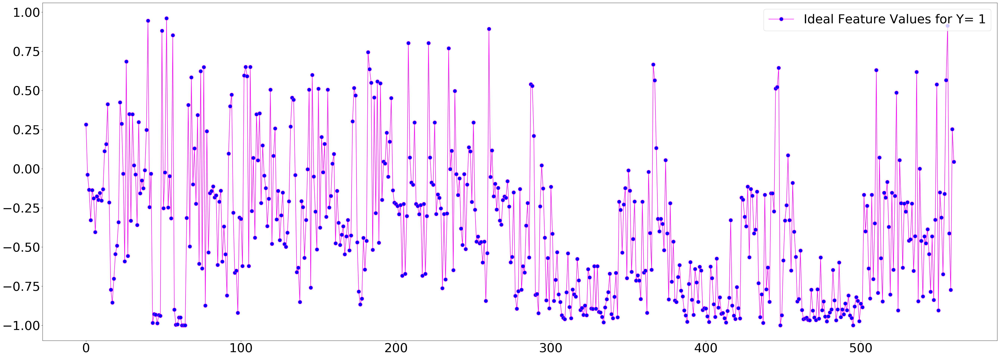

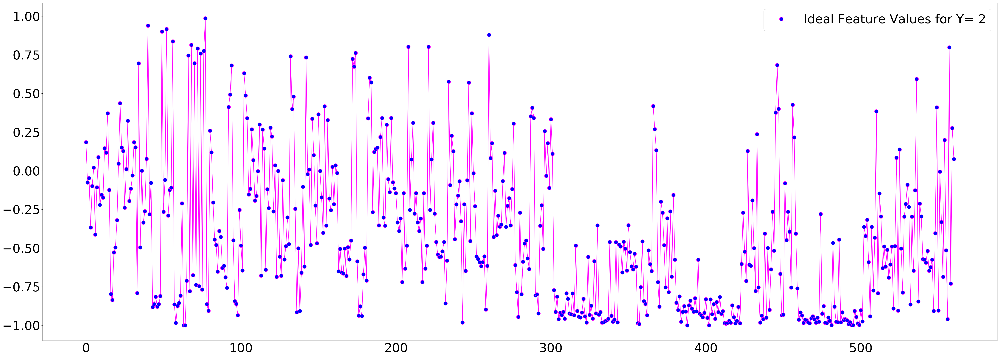

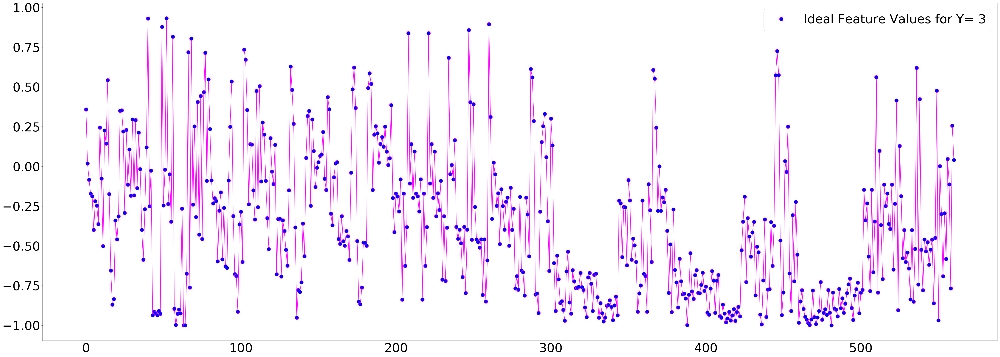

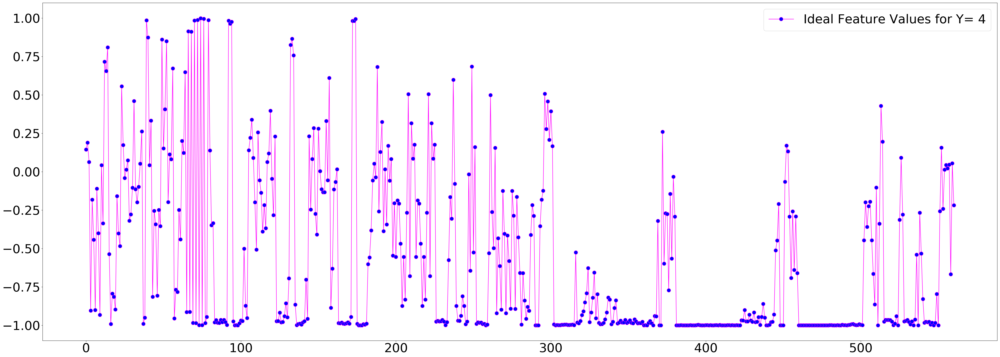

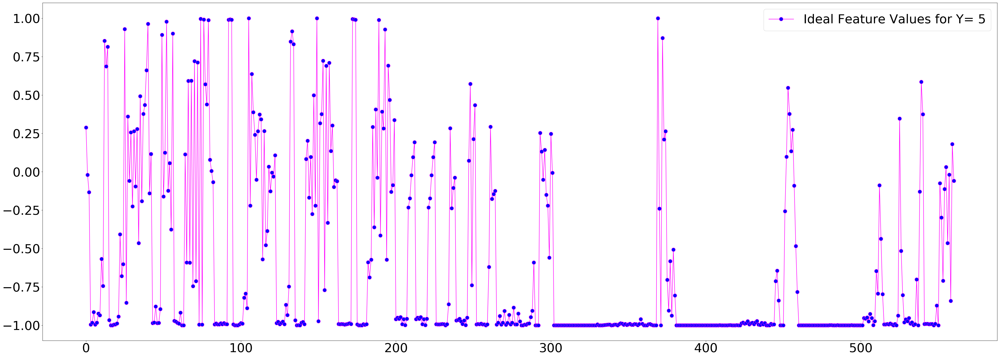

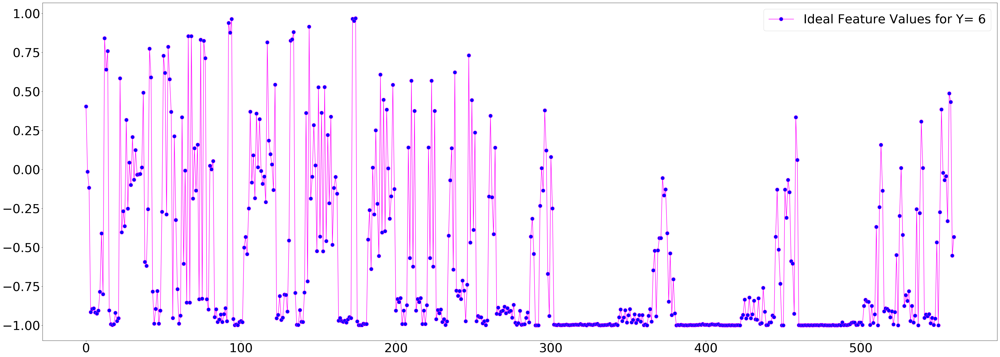

In [4]:
for i in range(1,7,1):
    visualizing_y(i)
plt.show()

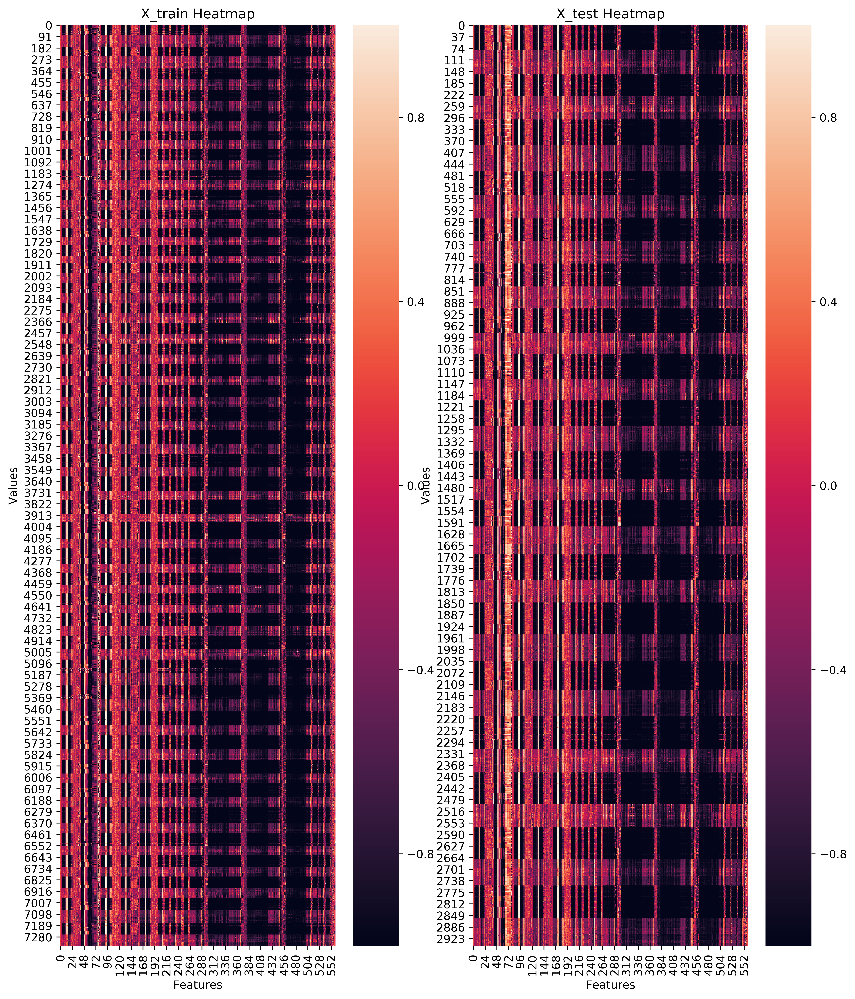

In [5]:
fig=plt.figure(figsize=(12, 15), dpi= 600, facecolor='w', edgecolor='k')
plt.rcParams.update({'font.size': 10})
plt.subplot(1,2,1)
plot_1=sns.heatmap(X_train)
plt.title("X_train Heatmap")
plt.xlabel('Features')
plt.ylabel('Values')
plt.subplot(1,2,2)
plot_2=sns.heatmap(X_test)
plt.title("X_test Heatmap")
plt.xlabel('Features')
plt.ylabel('Values')
plt.show()

#### .


In [5]:
logreg=linear_model.LogisticRegression(C=2)
logreg.fit(X_train,Y_train)
Y_predict=logreg.predict(X_test)

In [6]:
print("What activity is the person is doing, predicted according to X_test\nHere:-\n 1 is for WALKING\n2 is for WALKING UPSTAIRS\n3 WALKING DOWNSTAIRS\n4 is for SITTING\n5 is for  STANDING\n6 is for LAYING\n")
print(Y_predict)
Y_predict_array=np.array(Y_predict)

What activity is the person is doing, predicted according to X_test
Here:-
 1 is for WALKING
2 is for WALKING UPSTAIRS
3 WALKING DOWNSTAIRS
4 is for SITTING
5 is for  STANDING
6 is for LAYING

[5. 5. 5. ... 2. 2. 2.]


In [7]:
print("The value of correct activity:-\n Here:-\n 1 is for WALKING\n2 is for WALKING UPSTAIRS\n3 WALKING DOWNSTAIRS\n4 is for SITTING\n5 is for  STANDING\n6 is for LAYING\n")
print(Y_test)

The value of correct activity:-
 Here:-
 1 is for WALKING
2 is for WALKING UPSTAIRS
3 WALKING DOWNSTAIRS
4 is for SITTING
5 is for  STANDING
6 is for LAYING

[5. 5. 5. ... 2. 2. 2.]


In [8]:
correct_Y=0
len_Y_test=[]
for i in range(len(Y_test)):
    len_Y_test.append(i)
    if Y_predict_array[i]==Y_test[i]:
        correct_Y+=1
print("Total number of activities predicted corectly is ",correct_Y, " out of ",len(Y_test))

Total number of activities predicted corectly is  2837  out of  2947


### Percentage of Correctly Predicted columns :-

In [9]:
per=(correct_Y/len(Y_test))*100
print("Percentage of Y predicted correctly: ",per)

Percentage of Y predicted correctly:  96.26739056667797


In [10]:
def chunks(array_name,initial_limit,final_limit):
    m=[]
    for i in range(len(array_name)):
        if i>=initial_limit and i<final_limit:
            m.append(array_name[i])
    return m;

In [11]:
def plot_graph(initial_limit,final_limit):
    x= chunks(len_Y_test,initial_limit,final_limit)
    y= chunks(Y_predict_array,initial_limit,final_limit)
    z= chunks(Y_test,initial_limit,final_limit)
    fig=plt.figure(figsize=(55, 20), dpi= 300, facecolor='w', edgecolor='w')
    plt.rcParams.update({'font.size': 50})
    title="From "+str(initial_limit)+" to "+str(final_limit)
    plt.title(title)
    plt.xlabel('Values')
    plt.ylabel('Activity')
    plt.plot(x, y, marker='o',color='red',markerfacecolor='blue', label='Y Predicted Wrong')
    plt.plot(x, z, marker='o',color='cyan',markerfacecolor='magenta', label='Actual Y')
    plt.legend(loc='upper right')
    plt.show()

In [12]:
gap=500
for i in range(0,3000,gap):
    plot_graph(i,i+gap)
    

# Predicting the value of Y using entered values :-

### Data Preproccesing :-

In [15]:
def score_append(i):
    x=X_train[:,i:i+1]
    y=Y_train
    logreg.fit(x,y)
    score.append(logreg.score(x,y))

In [16]:
score=[]
for i in range(len(X_train[1,:])):
    score_append(i)
score_array=np.array(score)
print(score_array.shape)

(561,)


#### Selecting Right columns :-

In [17]:
column_head=np.array(column_head)
sum=0
right_columns=[]
right_columns_test=[]
right_columns_head=[]
for i in  range(len(score_array)):
    if float(score_array[i])>=0.4515:
        sum+=1
        right_columns.append(X_train[:,i])
        right_columns_head.append(column_head[i])
        right_columns_test.append(X_test[:,i])

print("Number of Column selected on the basis of score: ",sum)

Number of Column selected on the basis of score:  15


In [18]:
right_columns_head_array=np.array(right_columns_head)
right_columns_head_array=np.ndarray.transpose(right_columns_head_array)

right_columns_array=np.array(right_columns)
right_columns_array_transpose=np.ndarray.transpose(right_columns_array)
right_columns_test_array=np.array(right_columns_test)
right_columns_test_array_transpose=np.ndarray.transpose(right_columns_test_array)

### Saving the right column matrix along with their column head to a csv file: "right_columns.csv"

In [19]:
right_columns_test_array_transpose_col= np.r_[right_columns_head_array,right_columns_test_array_transpose]
np.savetxt("right_columns.csv", right_columns_test_array_transpose_col, delimiter=",",fmt='%s')

In [20]:
x=right_columns_array_transpose
y=Y_train
logreg1= linear_model.LogisticRegression(C=5)
logreg1.fit(x,y)
Y_pred=logreg1.predict(right_columns_test_array_transpose)

#### The probablity of correctly predicting the value of Y using these columns :-

In [21]:
logreg1.score(right_columns_test_array_transpose,Y_test)

0.8035290125551409

In [22]:
def column_values_function(value):
    column_values=[]
    for i in range(len(Y_test)):
        if Y_test[i]==value:
            column_values.append(right_columns_test_array_transpose[i,:])
    column_values=np.array(column_values)
    return column_values 

In [23]:
def ideal_values_function(value):
    ideal_values=[]
    column_values= column_values_function(value)
    for i in range(len(column_values[0])):
        y= column_values[:,i].mean()
        ideal_values.append(y)
    return ideal_values

#### Giving Input :-

In [1]:
input_test=[]
for i in range(sum):
    print("Enter the value of ",right_columns_head[i]," :-")
    value_of_feature=float(input())
    input_test.append(value_of_feature)
    

TypeError: 'builtin_function_or_method' object cannot be interpreted as an integer

In [25]:
input_test_array=np.array(input_test)
input_test_array_1 = np.c_[input_test_array , np.ones(len(input_test_array))]

In [26]:
input_test_array_transpose=np.ndarray.transpose(input_test_array_1)

In [27]:
Y_pred=logreg1.predict(input_test_array_transpose)
Y_pred=np.array(Y_pred)
Y_pred=Y_pred[0]
if Y_pred==1:
    activity="Walking"
elif Y_pred==2:
    activity="Walking Upstairs"
elif Y_pred==3:
    activity="Walking Downstairs"
elif Y_pred==4:
    activity="Sitting"
elif Y_pred==5:
    activity="Standing"
elif Y_pred==6:
    activity="Laying"

#### Predicted Value of Y according to Entered Values :-

In [28]:
print("Predicted value of Y=",Y_pred," which means the person is ",activity)

Predicted value of Y= 4.0  which means the person is  Sitting


In [29]:
mean_list=[]
for i in range(1,7,1):    
    correct_feature_values= ideal_values_function(i)
    difference=0
    for j in range(len(right_columns)):
        dif=abs(correct_feature_values[j]-input_test_array[j])
        difference+=dif
        mean=difference/len(right_columns)
    mean_list.append(mean)       
mean_list=np.array(mean_list)
print(mean_list)

[4.33137848 4.30905069 4.09271315 4.70048052 4.73946059 4.6191645 ]


In [30]:
result1 = np.where(mean_list == np.amin(mean_list))
other_predicted_value=((result1[0])+1)

In [31]:
print("Y can also be :",other_predicted_value)

Y can also be : [3]


In [32]:
def comparision_plot(string):
    correct_feature_values= ideal_values_function(Y_pred)
    label=string+str(Y_pred)
    fig=plt.figure(figsize=(55, 20), dpi=120,facecolor='w', edgecolor='w')
    plt.rcParams.update({'font.size': 40})
    plt.plot(correct_feature_values,marker='o', color='magenta',markerfacecolor='red', markersize=20,mec='none',label=label)
    plt.plot(input_test_array,marker='o', color='cyan',markerfacecolor='blue', markersize=20,mec='none',label="Input Feature Value")

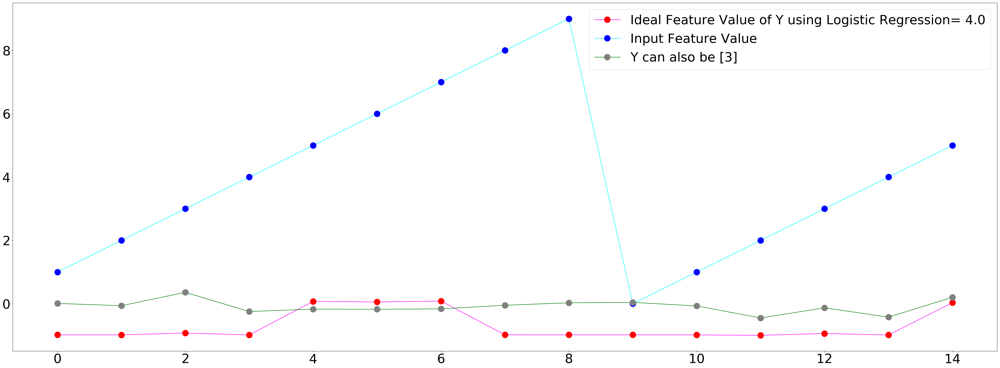

In [33]:
if other_predicted_value==Y_pred:
    comparision_plot("Ideal Feature Values for Y= ")
    plt.legend()
    plt.show()
else:
    correct_using_mean= ideal_values_function(other_predicted_value)
    label1="Y can also be "+ str(other_predicted_value)
    comparision_plot("Ideal Feature Value of Y using Logistic Regression= ")
    plt.plot(correct_using_mean,marker='o', color='green',markerfacecolor='grey', markersize=20,mec='none',label=label1)
    plt.legend()
    plt.show()

In [34]:
whos

Variable                                 Type                  Data/Info
------------------------------------------------------------------------
X_test                                   ndarray               2947x561: 1653267 elems, type `float64`, 13226136 bytes (12.613426208496094 Mb)
X_train                                  ndarray               7352x561: 4124472 elems, type `float64`, 32995776 bytes (31.46722412109375 Mb)
Y_pred                                   float64               4.0
Y_predict                                ndarray               2947: 2947 elems, type `float64`, 23576 bytes
Y_predict_array                          ndarray               2947: 2947 elems, type `float64`, 23576 bytes
Y_test                                   ndarray               2947: 2947 elems, type `float64`, 23576 bytes
Y_train                                  ndarray               7352: 7352 elems, type `float64`, 58816 bytes
activity                                 str                   Sit